In [1]:
import warnings
warnings.filterwarnings('ignore',category=RuntimeWarning)
import xarray as xr
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import glob,os,sys
from tqdm import tqdm
import proplot as plot
import json,pickle
import dask.array as da
import gc
from sklearn.decomposition import PCA
sys.path.insert(1, '/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/')
from tools import derive_var,read_and_proc,preproc_noensemble
from tools.mlr import mlr,maria_IO
from tools.preprocess import do_eof,preproc_maria
import feature_select
%matplotlib inline
#%matplotlib notebook
plot.rc.update({'figure.facecolor':'w','axes.labelweight':'ultralight',
                'tick.labelweight':'ultralight','gridminor.linestyle':'--','title.weight':'normal','linewidth':0.5})
#from dask import delayed
#from dask.distributed import Client
#import dask.array as da
#client = Client(processes=True, threads_per_worker=1,n_workers=2)

/tmp/ipykernel_2292384/866516716.py:22: ProplotWarning: rc setting 'linewidth' was renamed to 'meta.width' in version 0.8.
  plot.rc.update({'figure.facecolor':'w','axes.labelweight':'ultralight',


#### Produce Input-Output

#### Generate normalized time series

In [2]:
# Basic settings
folderpath='/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/pca/output/uvwheat/preproc/24h_smoo/'
expname = ['ctl','ncrf_36h','ncrf_60h','lwcrf']
varname = ['u','v','w','qv','theta','heatsum']
#################################################################################
# 24-hr smoothing model
nummem = [4, 2, 32, 2, 16, 6]
PCAdict = read_and_proc.depickle(folderpath+'PCA/ctl_PCA_dict1')
flatvar = [read_and_proc.depickle(folderpath+str(expname[i])+'_'+'preproc_dict1') for i in range(len(expname))]
vardicts = maria_IO.input_output(PCAdict,folderpath,varname,nummem).readvar(listdict=flatvar,varname=varname,withtheta='No',thetaflat=None,smooth24=True)
# Heat equation
#irvar,noirvar = read_and_proc.depickle(folderpath+'IR_'+'preproc_dict1'),read_and_proc.depickle(folderpath+'NOIR_'+'preproc_dict1')
#vardicts = maria_IO.input_output(PCAdict,folderpath,varname,nummem).readvar_sen(listdict=flatvar,thetaflat=thetavar,heatcompflat=noirvar)
#del flatvar,thetavar
#gc.collect()

In [5]:
qvheat = [np.abs(PCAdict[i].explained_variance_ratio_.cumsum()-0.95).argmin() for i in ['qv','heatsum']]
#theta = np.abs(PCAtheta['theta'].explained_variance_ratio_.cumsum()-0.99).argmin()
print(f'qvheat commponents: {qvheat}')#; theta component: {theta}')

qvheat commponents: [2, 6]


##### Check components

In [3]:
import importlib
importlib.reload(maria_IO)
folderpath='/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/pca/output/uvwheat/preproc/24h_smoo/'
print(maria_IO.datacheck(folderpath,'PCA/ctl_PCA_dict1',True).dthdQVAR('dthdq_preproc_dict1','th',True))

[0.0, 0.2667876272923301, 0.2812553162992793, 0.3085273463448789, 0.353998419386372, 0.3633487348469624, 0.3652110608830849, 0.3679470761769728, 0.4089055374794459, 0.4345419715323001, 0.4410047039321978, 0.4450695653458289, 0.4463373273866434, 0.4484695118867032, 0.4503686848669643, 0.4559455219642938, 0.45664204980861445, 0.4569833814835364, 0.4660803176184614, 0.47168923416017955, 0.47197210939575607, 0.4743456331528314, 0.4781395323666591, 0.47887887568967236, 0.47925783850575393, 0.4804925041561225, 0.48052634198585004, 0.48102420689290365, 0.4811667850436537, 0.4815476967134443, 0.4817896392763109]


##### Save normalized and unnormalized TS

In [3]:
varname = ['u','v','w','qv','theta','heatsum']
nummem = [4, 2, 32, 2, 16, 6]
ts_dict = maria_IO.input_output(PCAdict,folderpath,varname,nummem).produce_timeseries(vardicts)
normalts_dict = maria_IO.input_output(PCAdict,folderpath,varname,nummem).normalize(ts=ts_dict)

In [4]:
folderpath='/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/pca/output/uvwheat/preproc/24h_smoo/'
expname = 'flatPCA_Q95_nonorm'
read_and_proc.save_to_pickle(folderpath+'processed/ts/'+str(expname)+'_'+'preproc_dict1',ts_dict,'PICKLE')
expname = 'flatPCA_Q95'
read_and_proc.save_to_pickle(folderpath+'processed/ts/'+str(expname)+'_'+'preproc_dict1',normalts_dict,'PICKLE')

##### Save heat equations

In [3]:
varname = ['u','v','w','qv','theta','heatsum','heatcomp']
nummem = [22,8,35,5,19,29,29]
PCAdict['theta'] = PCAtheta['theta']
del PCAtheta
gc.collect()
ts_dict = maria_IO.input_output(PCAdict,folderpath,varname,nummem).produce_sentimeseries(vardicts)

varname = ['u','v','w','qv','theta','heatsum']
normalts_dict = maria_IO.input_output(PCAdict,folderpath,varname,nummem).normalize_sen(ts=ts_dict)

In [5]:
folderpath='/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/'

expname = 'flatPCA_noir_nonorm'
read_and_proc.save_to_pickle(folderpath+'pca/output/flatvar/'+str(expname)+'_'+'preproc_dict1',ts_dict,'PICKLE')
expname = 'flatPCA_noir'
read_and_proc.save_to_pickle(folderpath+'pca/output/flatvar/'+str(expname)+'_'+'preproc_dict1',normalts_dict,'PICKLE')

#### Generate Input Dictionary

In [5]:
expname = 'flatPCA_Q95'
folderpath='/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/pca/output/uvwheat/preproc/24h_smoo/'
norml_ts = read_and_proc.depickle(folderpath+'processed/ts/'+str(expname)+'_'+'preproc_dict1')
nonorml_ts = read_and_proc.depickle(folderpath+'processed/ts/'+str(expname)+'_nonorm'+'_'+'preproc_dict1')

In [6]:
# Basic settings
folderpath='/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/pca/output/uvwheat/preproc/24h_smoo/'
expname = ['ctl','ncrf_36h','ncrf_60h','lwcrf']
varname = ['u','v','w','qv','theta','heatsum']
nummem = [4, 2, 32, 2, 16, 6]
PCAdict = read_and_proc.depickle(folderpath+'PCA/ctl_PCA_dict1')

input_dict = maria_IO.input_output(PCAdict,folderpath,varname,nummem).create_input(norml_ts,expname,24,2)
LDTME = np.linspace(0,44,45)+1
mlr_output = []
for index,TIMEstamp in enumerate(LDTME):
    mlr_output.append(maria_IO.input_output(PCAdict,folderpath,varname,nummem).produce_output_LT(nonorml_ts,expname,int(TIMEstamp),nummem,24,2))

dt
dtth
dtthuvw
dtthuv
uv
uvw
dtuv
dtuvw
dtthuvwqv


In [7]:
folderpath='/work/FAC/FGSE/IDYST/tbeucler/default/freddy0218/TCGphy/2020_TC_CRF/dev/freddy0218/pca/output/uvwheat/preproc/24h_smoo/'
expname = 'inputQ95_dict'
read_and_proc.save_to_pickle(folderpath+'processed/inputoutput/'+str(expname)+'_'+'smoo6_withtheta',input_dict,'PICKLE')
expname = 'outputQ95_dict'
read_and_proc.save_to_pickle(folderpath+'processed/inputoutput/'+str(expname)+'_'+'smoo6_withtheta',mlr_output,'PICKLE')

In [8]:
input_dict['dtthuvw'].shape

(330, 60)

Animation size has reached 21389942 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


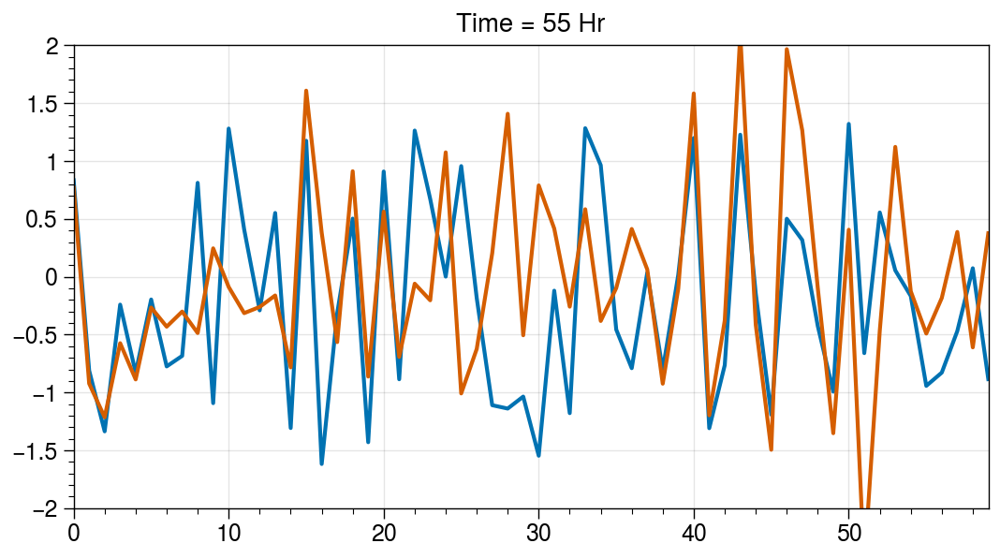

In [9]:
import matplotlib.animation as animation
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

fig,axs = plot.subplots(ncols=1,nrows=1,axwidth=4.595,refaspect=2.031)
l, = axs[0].plot([],[])
l2, = axs[0].plot([],[])
axs.format(xlim=[0,59],ylim=[-2,2])

def animate(i):
    time = 36+i
    axs[0].set_title(u"Time = {} Hr".format(time))
    #print(input_dict['dtthuvw'][10+i,:])
    l.set_data(np.linspace(0,59,60),input_dict['dtthuvw'][10+i,:])
    l2.set_data(np.linspace(0,59,60),input_dict['dtthuvw'][96+i,:])

ani = animation.FuncAnimation(fig, animate, frames=20, blit=False, repeat=False)
ani.save('./figures/PC_testanim_smoo24.mp4', writer='ffmpeg', fps=10, dpi=100) #metadata={'title':'test'})
HTML(ani.to_jshtml())